<a href="https://colab.research.google.com/github/OulaSu/derma_trio_image_classifier/blob/main/derma_trio_image_classifier.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Derma Trio Classifier 📸

an image classifier to distinguish between 3 medical conditions:

1.   **Eczema:** a skin condition characterized by red, itchy rashes anywhere on the body. It often occurs in patches and is linked to a combination of genetic and environmental factors.

2.   **Urticaria:** commonly known as **hives**, presents as raised, itchy welts on the skin that can vary in size and shape. It is usually triggered by an allergic reaction or stress and typically resolves on its own.

3.   **Rosacea:** a chronic skin condition that causes redness and visible blood vessels on the face, often accompanied by small, pus-filled bumps.


built on ***resnet34***, based on an image dataset obtained from Bing Image search API. It's my first model, you can **try it out** and upload your image to get your predictions.

Next improvements will include transfer learning, and who knows what else! 😃

## Setup & Image Download

In [ ]:
pip install fastbook

In [ ]:
pip install azure-cognitiveservices-search-imagesearch

In [6]:
#library Setup (necessary for Try-it-out section)
from fastai.vision.all import *
from ipywidgets import widgets
import fastbook
fastbook.setup_book()
from fastbook import *
from fastai.vision.widgets import *
import os

Mounted at /content/gdrive


In [7]:
from azure.cognitiveservices.search.imagesearch import ImageSearchClient as api
from msrest.authentication import CognitiveServicesCredentials as auth

Get Azure Key to load the image bing search and define a search_images_bing function

In [8]:
key = os.environ.get('AZURE_SEARCH_KEY', 'f79897e8c0b5483abc8c1ddfd9c7f4a6')

def search_images_bing(key, term, min_sz=128, max_images=500):
     params = {'q':term, 'count':max_images, 'min_height':min_sz, 'min_width':min_sz}
     headers = {"Ocp-Apim-Subscription-Key":key}
     search_url = "https://api.bing.microsoft.com/v7.0/images/search"
     response = requests.get(search_url, headers=headers, params=params)
     response.raise_for_status()
     search_results = response.json()
     return L(search_results['value'])

In [9]:
results = search_images_bing(key, 'eczema')
ims = results.attrgot('contentUrl')

# Check
print(len(ims))
print(ims[0])

150
https://www.thehealthy.com/wp-content/uploads/2017/08/shutterstock_522715072.jpg


use fastai's download_images to download all the URLs for each of our search terms. We'll put each in a separate folder:

In [10]:
derma_conditions = 'eczema','urticaria','rosacea'
path = Path('derma_conditions')


if not path.exists():
    path.mkdir()
    for o in derma_conditions:
        dest = (path/o)
        dest.mkdir(exist_ok=True)
        results = search_images_bing(key, f'{o}')
        download_images(dest, urls=results.attrgot('contentUrl'))

In [11]:
fns = get_image_files(path)
fns

(#409) [Path('derma_conditions/rosacea/44a9929e-40a6-4a59-858c-94756ef3c351.jpg'),Path('derma_conditions/rosacea/14d9a7e5-49be-4691-85c7-ae55ab3f5fb3.jpg'),Path('derma_conditions/rosacea/630ca675-c87d-40c3-a72a-a07cdfe5661c.png'),Path('derma_conditions/rosacea/b88697d4-82a1-4c54-a852-98b576df7735.jpg'),Path('derma_conditions/rosacea/5b2cff51-bc13-4494-afbb-69c1baa7b4b2.jpg'),Path('derma_conditions/rosacea/32b92665-e1ee-4e53-97c7-baddb77a4b14.jpg'),Path('derma_conditions/rosacea/e282d6ef-62f5-4b90-91ee-475430bcaf68.jpg'),Path('derma_conditions/rosacea/d5496de0-a812-42a5-b7b5-1908b37783a0.jpg'),Path('derma_conditions/rosacea/60b1becd-7820-4ae9-86ef-3f1c2dcd5d39.jpg'),Path('derma_conditions/rosacea/1df35fd3-5317-43ae-94b5-d73b83e899e0.jpeg')...]

Often when we download files from the internet, there are a few that are corrupt. Let's check and unlink

In [12]:
failed = verify_images(fns)
failed.map(Path.unlink);

## DataBlock, DataLoader & Augmentation

Creating a DataBlock with presizing to a big image and then doing the augmentation

In [13]:
conditions = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,
    splitter=RandomSplitter(valid_pct=0.2, seed=42),
    get_y=parent_label,
    item_tfms=Resize(460),
    batch_tfms=aug_transforms(size=224, min_scale=0.75))

# put into a DataLoader
dls = conditions.dataloaders(path)

a look at a few of those items by calling the `show_batch` method on a DataLoader



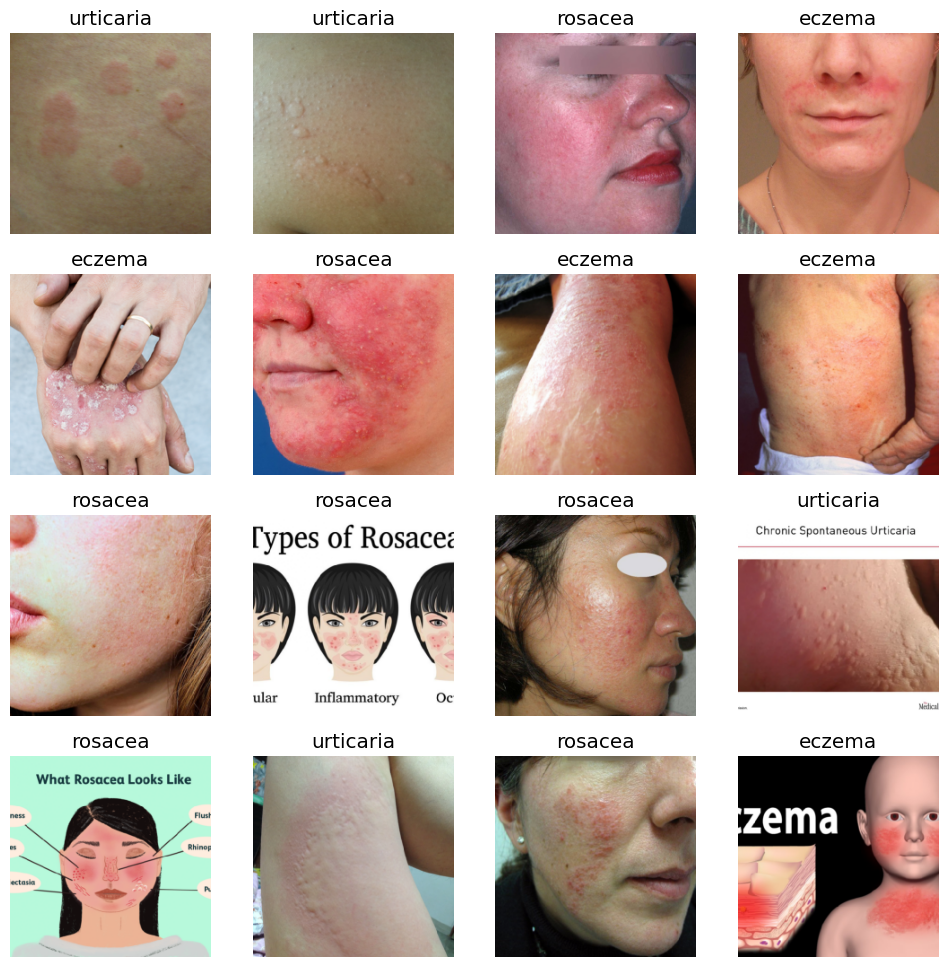

In [14]:
dls.valid.show_batch(max_n=16, nrows=4)

## First Training & Sanity Check

we will train on resnet34 for educational purposes, as well as, the dataset is not that large and due to computational resources

In [17]:
learn = vision_learner(dls, resnet34, metrics=error_rate)
learn.fine_tune(4)

epoch,train_loss,valid_loss,error_rate,time
0,1.858061,1.199366,0.487179,00:16


epoch,train_loss,valid_loss,error_rate,time
0,1.217111,0.750721,0.282051,00:17
1,1.134488,0.433681,0.141026,00:17
2,0.971850,0.366511,0.153846,00:17
3,0.874550,0.328667,0.141026,00:17


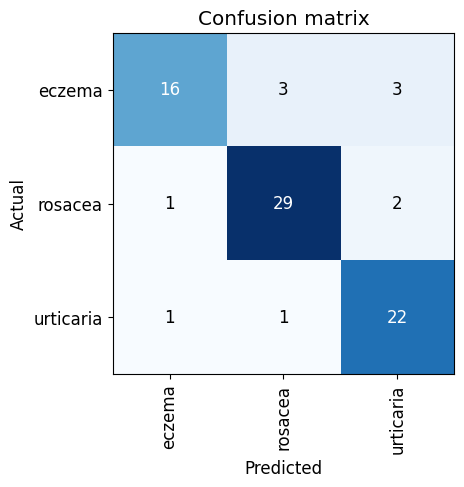

In [18]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

Now, we'll use the cleaner to show the images with highest loss and modify the data.
Note: the output are images with buttons to delete or change category. It may not be shown on published version

In [19]:
cleaner = ImageClassifierCleaner(learn)
cleaner

In [20]:
# to apply the changes done with the buttons
for idx in cleaner.delete(): cleaner.fns[idx].unlink()
for idx,cat in cleaner.change(): shutil.move(str(cleaner.fns[idx]), path/cat)

**Note**: drawing images, presentation screednshots and educational material were the images mostly deleted from the dataset, which, of course causes imbalance in the validationg data set.

### Training 2 with cleaner Data

In [21]:
# DataBlock
conditions = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,
    splitter=RandomSplitter(valid_pct=0.2, seed=42),
    get_y=parent_label,
    item_tfms=Resize(460),
    batch_tfms=aug_transforms(size=224, min_scale=0.75))

# put into a DataLoader
dls = conditions.dataloaders(path)

In [22]:
# New Learner
learn = vision_learner(dls, resnet34, metrics=error_rate)
learn.fine_tune(4)

epoch,train_loss,valid_loss,error_rate,time
0,1.775128,1.189854,0.467532,00:16


epoch,train_loss,valid_loss,error_rate,time
0,1.155976,0.825460,0.324675,00:17
1,0.988847,0.737873,0.311688,00:16
2,0.845394,0.729460,0.285714,00:16
3,0.753494,0.751084,0.324675,00:15


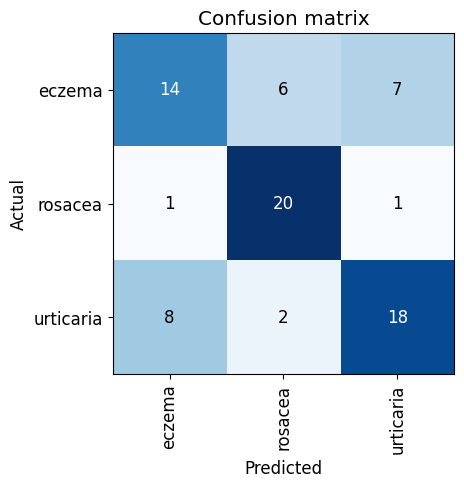

In [23]:
# plot
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

In [24]:
# Clean
cleaner = ImageClassifierCleaner(learn)
cleaner

In [25]:
# to apply the changes
for idx in cleaner.delete(): cleaner.fns[idx].unlink()
for idx,cat in cleaner.change(): shutil.move(str(cleaner.fns[idx]), path/cat)

### Training & cleaning 3

In [26]:
# DataBlock
conditions = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,
    splitter=RandomSplitter(valid_pct=0.2, seed=42),
    get_y=parent_label,
    item_tfms=Resize(460),
    batch_tfms=aug_transforms(size=224, min_scale=0.75))

# put into a DataLoader
dls = conditions.dataloaders(path)

In [27]:
# New Learner
learn = vision_learner(dls, resnet34, metrics=error_rate)
learn.fine_tune(4)

epoch,train_loss,valid_loss,error_rate,time
0,1.879498,0.994270,0.402597,00:16


epoch,train_loss,valid_loss,error_rate,time
0,1.093331,0.902716,0.389610,00:17
1,0.980775,0.773186,0.272727,00:16
2,0.833027,0.820376,0.272727,00:17
3,0.738581,0.784748,0.246753,00:16


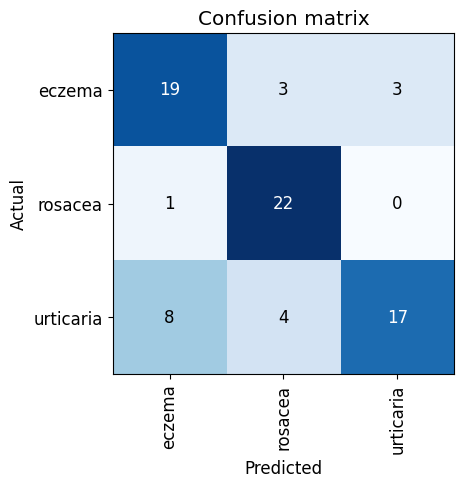

In [28]:
# plot
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

In [30]:
# Clean
cleaner = ImageClassifierCleaner(learn)
cleaner

In [31]:
# to apply the changes
for idx in cleaner.delete(): cleaner.fns[idx].unlink()
for idx,cat in cleaner.change(): shutil.move(str(cleaner.fns[idx]), path/cat)

In [32]:
# Loading data for next learner
# DataBlock
conditions = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,
    splitter=RandomSplitter(valid_pct=0.2, seed=42),
    get_y=parent_label,
    item_tfms=Resize(460),
    batch_tfms=aug_transforms(size=224, min_scale=0.75))

# put into a DataLoader
dls = conditions.dataloaders(path)

## Model Optimisation

Finding a suitable **learning rate**

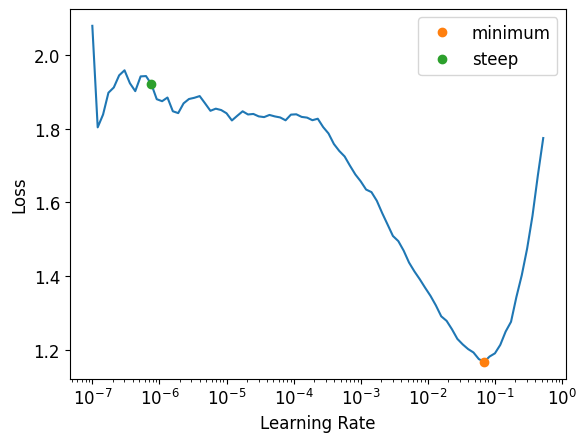

In [33]:
learn = vision_learner(dls, resnet34, metrics=error_rate)
lr_min,lr_steep = learn.lr_find(suggest_funcs=(minimum, steep))

In [34]:
print(f"Minimum/10: {lr_min:.2e}, steepest point: {lr_steep:.2e}")

Minimum/10: 6.92e-03, steepest point: 7.59e-07


We can see on this plot that in the range 1e-6 to 1e-3, nothing really happens and the model doesn't train. Then the loss starts to decrease until it reaches a minimum, and then increases again. We don't want a learning rate greater than 1e-1, which is already too high: at this stage we've left the period where the loss was decreasing steadily. In this learning rate plot it appears that a learning rate around **3e-3** would be appropriate

In [38]:
# DataBlock
conditions = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,
    splitter=RandomSplitter(valid_pct=0.2, seed=42),
    get_y=parent_label,
    item_tfms=Resize(460),
    batch_tfms=aug_transforms(size=224, min_scale=0.75))

# put into a DataLoader
dls = conditions.dataloaders(path)

#learner
learn = vision_learner(dls, resnet34, metrics=error_rate)
learn.fine_tune(4, base_lr=3e-3)

epoch,train_loss,valid_loss,error_rate,time
0,1.755229,0.949574,0.402597,00:17


epoch,train_loss,valid_loss,error_rate,time
0,1.073936,0.760477,0.298701,00:17
1,0.981335,0.843507,0.272727,00:16
2,0.908120,0.849066,0.220779,00:18
3,0.798733,0.848892,0.207792,00:29


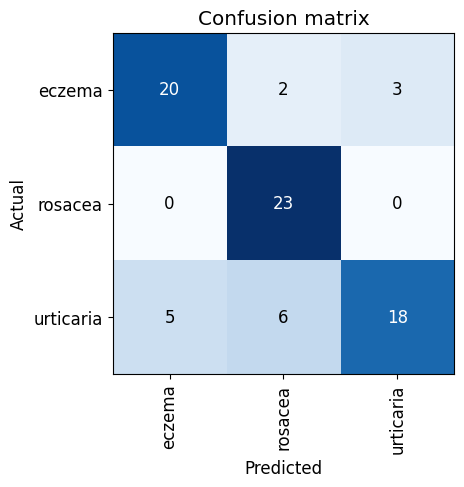

In [39]:
# plot
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

In [40]:
# Export learner
learn.export()
path = Path()
path.ls(file_exts='.pkl')

(#1) [Path('export.pkl')]

# Try it out 🚀

In [ ]:
# If you're starting the notebook here, make sure to import ibraries in Setup

load the learner

In [41]:
learn_inf = load_learner(path/'export.pkl')

We'll make an upload button

In [42]:
btn_upload = widgets.FileUpload()
btn_upload

FileUpload(value={}, description='Upload')

In [43]:
img = PILImage.create(btn_upload.data[-1])
out_pl = widgets.Output()
out_pl.clear_output()
with out_pl: display(img.to_thumb(128,128))
out_pl

Output()

Then we can get our predictions: and use a Label to display them:

In [44]:
pred,pred_idx,probs = learn_inf.predict(img)

In [49]:
lbl_pred = widgets.Label()
lbl_pred.value = f'Prediction: {pred}; Probability: {probs[pred_idx]:.04f}'
lbl_pred

Label(value='Prediction: eczema; Probability: 0.4972')